# 加载数据

In [88]:
import pandas as pd
import numpy as np
import sklearn
import seaborn as sns
import matplotlib.pyplot as plt
import os

In [212]:
data = pd.read_csv("winequalityN.csv")

In [90]:
data.head()

,type,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,white,7.0,0.27,0.36,20.7,0.045,45.0,170.0,1.0010,3.00,0.45,8.8,6
1,white,6.3,0.30,0.34,1.6,0.049,14.0,132.0,0.9940,3.30,0.49,9.5,6
2,white,8.1,0.28,0.40,6.9,0.050,30.0,97.0,0.9951,3.26,0.44,10.1,6
3,white,7.2,0.23,0.32,8.5,0.058,47.0,186.0,0.9956,3.19,0.40,9.9,6
4,white,7.2,0.23,0.32,8.5,0.058,47.0,186.0,0.9956,3.19,0.40,9.9,6


In [191]:
data.drop('type',axis=1, inplace=True)

In [92]:
data.corr

<bound method DataFrame.corr of       fixed acidity  volatile acidity  citric acid  residual sugar  chlorides  \
0               7.0             0.270         0.36            20.7      0.045   
1               6.3             0.300         0.34             1.6      0.049   
2               8.1             0.280         0.40             6.9      0.050   
3               7.2             0.230         0.32             8.5      0.058   
4               7.2             0.230         0.32             8.5      0.058   
...             ...               ...          ...             ...        ...   
6492            6.2             0.600         0.08             2.0      0.090   
6493            5.9             0.550         0.10             2.2      0.062   
6494            6.3             0.510         0.13             2.3      0.076   
6495            5.9             0.645         0.12             2.0      0.075   
6496            6.0             0.310         0.47             3.6      0.067

In [93]:
data.columns

Index(['fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar',
       'chlorides', 'free sulfur dioxide', 'total sulfur dioxide', 'density',
       'pH', 'sulphates', 'alcohol', 'quality'],
      dtype='object')

In [94]:
data['quality'].unique()

array([6, 5, 7, 8, 4, 3, 9], dtype=int64)

In [189]:
# create a new column called Review 
#1 - Bad
#2 - Average
#3 - Excellent
#This will be split in the following way. 
#3,4,5 --> Bad
#6,7 --> Average
#8,9 --> Excellent
#Create an empty list called Reviews
reviews = []
for i in data['quality']:
    if i <= 5:
        reviews.append('1')
    elif i > 5 and i <= 7:
        reviews.append('2')
    elif i > 7 :
        reviews.append('3')
data['Reviews'] = reviews

In [190]:
#subset_attributes = ['alcohol', 'volatile acidity', 'pH', 'quality']
subset_attributes = data.columns
ls = round(data[data['Reviews'] == '1'][subset_attributes].describe(),2)
ms = round(data[data['Reviews'] == '2'][subset_attributes].describe(),2)
hs = round(data[data['Reviews'] == '3'][subset_attributes].describe(),2)
pd.concat([ls, ms, hs], axis=0, keys=['Low Quality Wine', 'Medium Quality Wine', 'High Quality Wine']).T

Low Quality Wine                                      \
                                count    mean    std   min    25%     50%   
fixed acidity                  2379.0    7.33   1.27  4.20   6.50    7.10   
volatile acidity               2382.0    0.40   0.19  0.10   0.26    0.34   
citric acid                    2383.0    0.30   0.16  0.00   0.21    0.29   
residual sugar                 2384.0    5.65   4.92  0.60   1.80    2.90   
chlorides                      2383.0    0.06   0.04  0.01   0.04    0.05   
free sulfur dioxide            2384.0   29.48  19.84  2.00  14.00   26.00   
total sulfur dioxide           2384.0  119.28  61.89  6.00  68.00  124.00   
density                        2384.0    1.00   0.00  0.99   0.99    1.00   
pH                             2381.0    3.21   0.16  2.74   3.11    3.20   
sulphates                      2382.0    0.52   0.14  0.25   0.44    0.50   
alcohol                        2384.0    9.87   0.84  8.00   9.30    9.60   
quality                        2384.0    4.88   0.36  3.00   5.00    5.00   

                                     Medium Quality Wine          ...          \
                         75%     max               count    mean  ...     75%   
fixed acidity           7.80   15.90              3911.0    7.16  ...    7.60   
volatile acidity        0.50    1.58              3909.0    0.31  ...    0.36   
citric acid             0.40    1.00              3913.0    0.33  ...    0.39   
residual sugar          8.52   23.50              3913.0    5.33  ...    7.90   
chlorides               0.08    0.61              3914.0    0.05  ...    0.06   
free sulfur dioxide    42.00  289.00              3915.0   30.96  ...   41.00   
total sulfur dioxide  167.00  440.00              3915.0  113.51  ...  150.00   
density                 1.00    1.00              3915.0    0.99  ...    1.00   
pH                      3.31    3.90              3909.0    3.22  ...    3.33   
sulphates               0.58    2.00              3913.0    0.54  ...    0.61   
alcohol                10.40   14.90              3915.0   10.81  ...   11.70   
quality                 5.00    5.00              3915.0    6.28  ...    7.00   

                             High Quality Wine                               \
                         max             count    mean    std    min    25%   
fixed acidity          15.60             197.0    6.85   1.15   3.90   6.20   
volatile acidity        1.04             198.0    0.29   0.12   0.12   0.21   
citric acid             1.66             198.0    0.33   0.10   0.03   0.28   
residual sugar         65.80             198.0    5.35   4.16   0.80   2.00   
chlorides               0.42             198.0    0.04   0.02   0.01   0.03   
free sulfur dioxide   112.00             198.0   34.51  17.08   3.00  24.00   
total sulfur dioxide  294.00             198.0  117.48  41.69  12.00  96.00   
density                 1.04             198.0    0.99   0.00   0.99   0.99   
pH                      4.01             198.0    3.23   0.16   2.88   3.13   
sulphates               1.95             198.0    0.51   0.16   0.25   0.38   
alcohol                14.20             198.0   11.69   1.27   8.50  11.00   
quality                 7.00             198.0    8.03   0.16   8.00   8.00   

                                              
                         50%     75%     max  
fixed acidity           6.80    7.30   12.60  
volatile acidity        0.28    0.35    0.85  
citric acid             0.32    0.37    0.74  
residual sugar          4.05    7.57   14.80  
chlorides               0.04    0.04    0.12  
free sulfur dioxide    34.00   43.00  105.00  
total sulfur dioxide  118.50  145.00  212.50  
density                 0.99    0.99    1.00  
pH                      3.23    3.33    3.72  
sulphates               0.48    0.60    1.10  
alcohol                12.00   12.60   14.00  
quality                 8.00    8.00    9.00  

[12 rows x 24 columns]

In [97]:
#view final data
data.columns

Index(['fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar',
       'chlorides', 'free sulfur dioxide', 'total sulfur dioxide', 'density',
       'pH', 'sulphates', 'alcohol', 'quality', 'Reviews'],
      dtype='object')

In [98]:
#count of each target variable
from collections import Counter
Counter(data['quality'])

Counter({6: 2836, 5: 2138, 7: 1079, 8: 193, 4: 216, 3: 30, 9: 5})

In [149]:
Counter(data['Reviews'])

Counter({'2': 3894, '1': 2372, '3': 197})

# 数据可视化

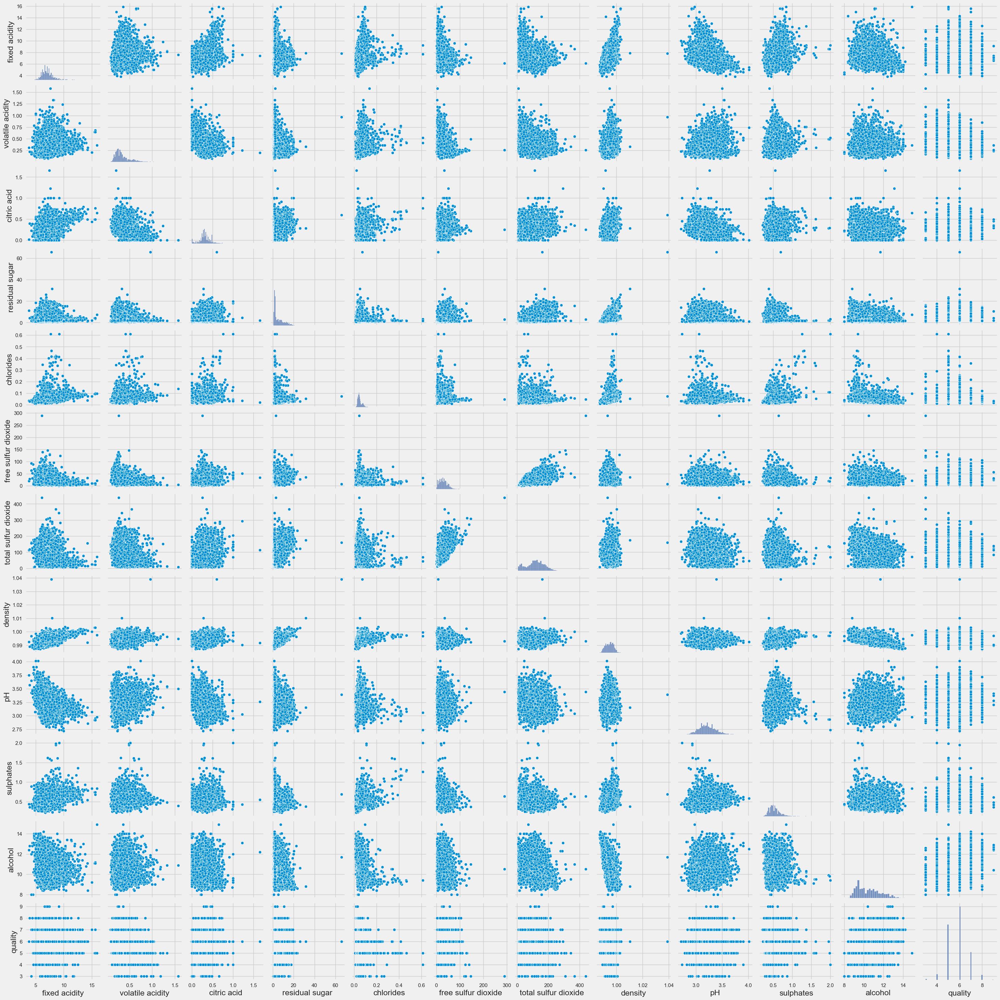

In [113]:
#Check correleation between the variables using Seaborn's pairplot. 
#ps: do not add 'Reviews' columns first if u want to see active pics
sns.pairplot(data)

In [115]:
data.describe()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
count,6487.000000,6489.000000,6494.000000,6495.000000,6495.000000,6497.000000,6497.000000,6497.000000,6488.000000,6493.000000,6497.000000,6497.000000
mean,7.216579,0.339691,0.318722,5.444326,0.056042,30.525319,115.744574,0.994697,3.218395,0.531215,10.491801,5.818378
std,1.296750,0.164649,0.145265,4.758125,0.035036,17.749400,56.521855,0.002999,0.160748,0.148814,1.192712,0.873255
min,3.800000,0.080000,0.000000,0.600000,0.009000,1.000000,6.000000,0.987110,2.720000,0.220000,8.000000,3.000000
25%,6.400000,0.230000,0.250000,1.800000,0.038000,17.000000,77.000000,0.992340,3.110000,0.430000,9.500000,5.000000
50%,7.000000,0.290000,0.310000,3.000000,0.047000,29.000000,118.000000,0.994890,3.210000,0.510000,10.300000,6.000000
75%,7.700000,0.400000,0.390000,8.100000,0.065000,41.000000,156.000000,0.996990,3.320000,0.600000,11.300000,6.000000
max,15.900000,1.580000,1.660000,65.800000,0.611000,289.000000,440.000000,1.038980,4.010000,2.000000,14.900000,9.000000


In [116]:
import matplotlib.pyplot as plt
# Function to create a histogram, and a boxplot and scatter plot.
def diagnostic_plots(df, variable,target):
    # The function takes a dataframe (df) and
    # the variable of interest as arguments.

    # Define figure size.
    plt.figure(figsize=(20, 4))

    # histogram
    plt.subplot(1, 4, 1)
    sns.histplot(df[variable], bins=30,color = 'r')
    plt.title('Histogram')

    # scatterplot
    plt.subplot(1, 4, 2)
    plt.scatter(df[variable],df[target],color = 'g')
    plt.title('Scatterplot')
    
    
    # boxplot
    plt.subplot(1, 4, 3)
    sns.boxplot(y=df[variable],color = 'b')
    plt.title('Boxplot')
    
    # barplot
    plt.subplot(1, 4, 4)
    sns.barplot(x = target, y = variable, data = df)   
    plt.title('Barplot')
    
    
    plt.show()

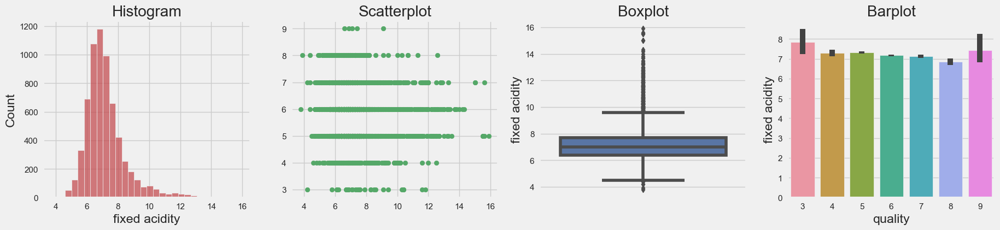

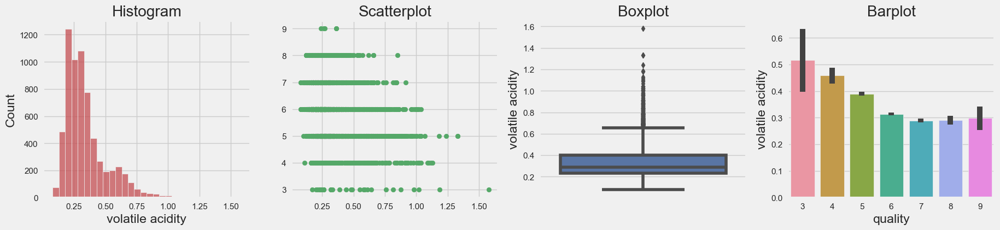

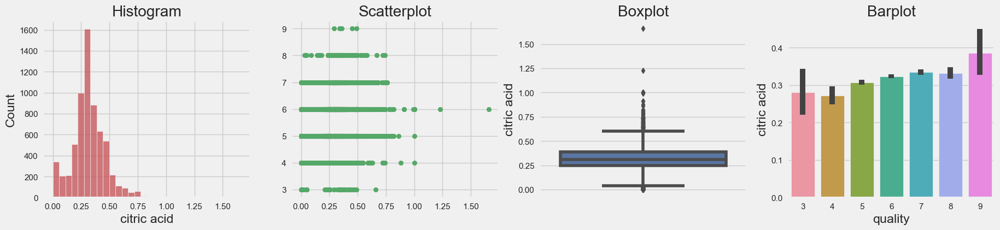

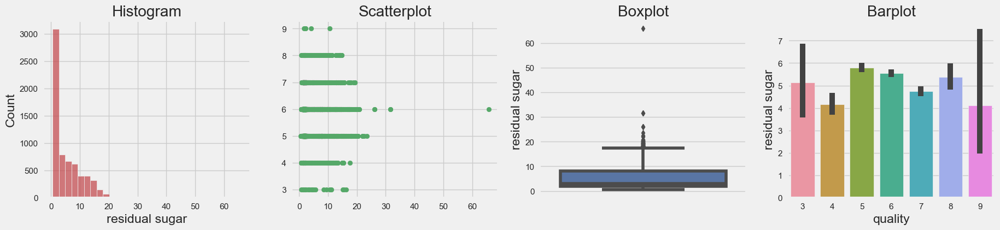

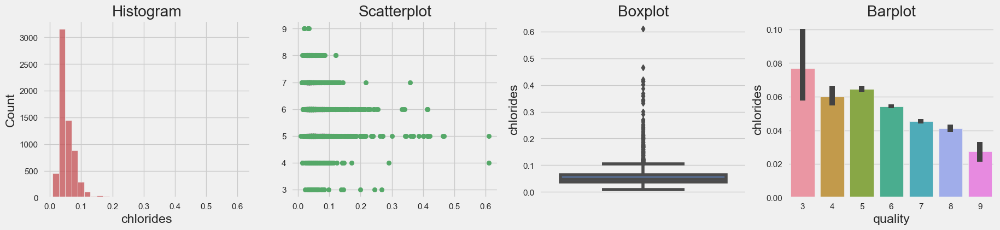

...

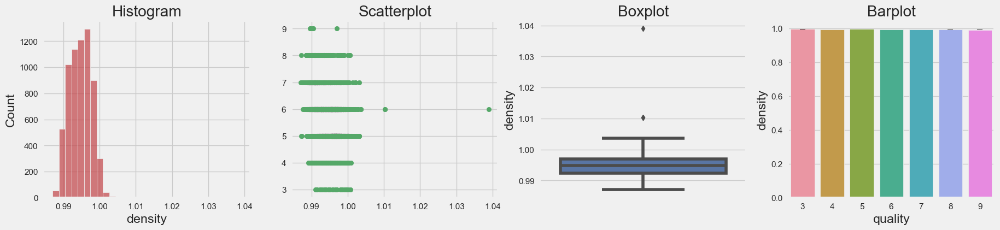

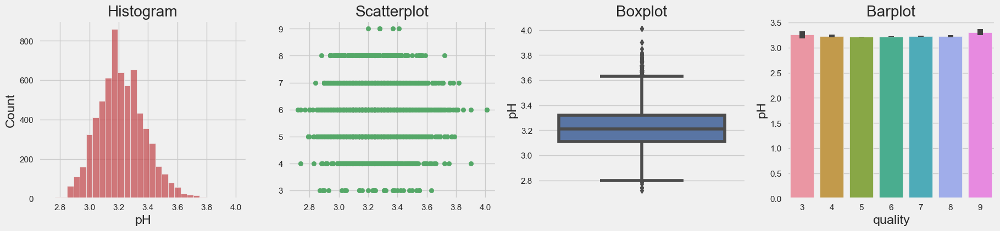

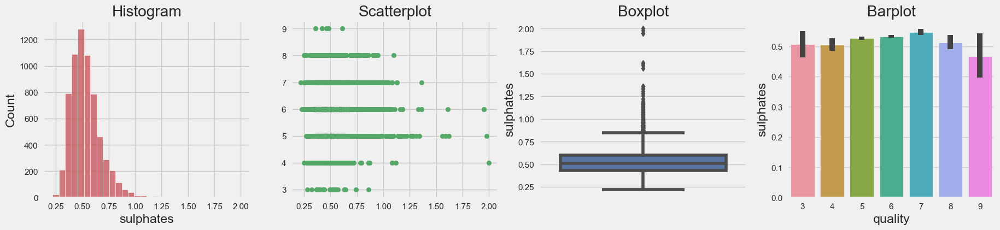

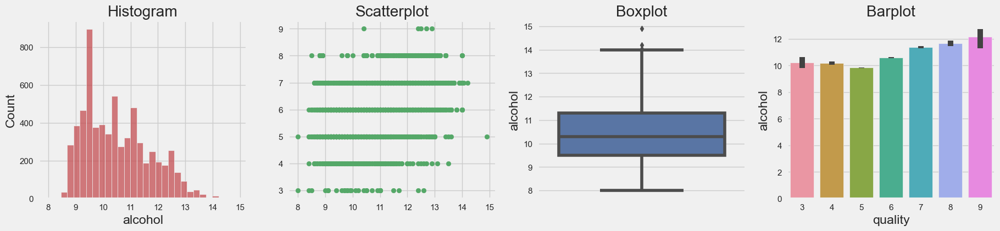

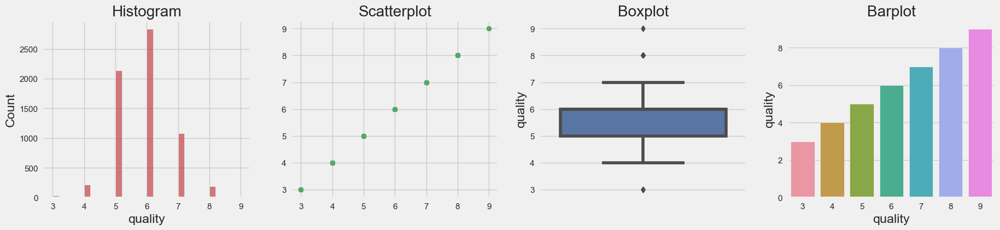

In [117]:
for variable in data:
    diagnostic_plots(data,variable,'quality')

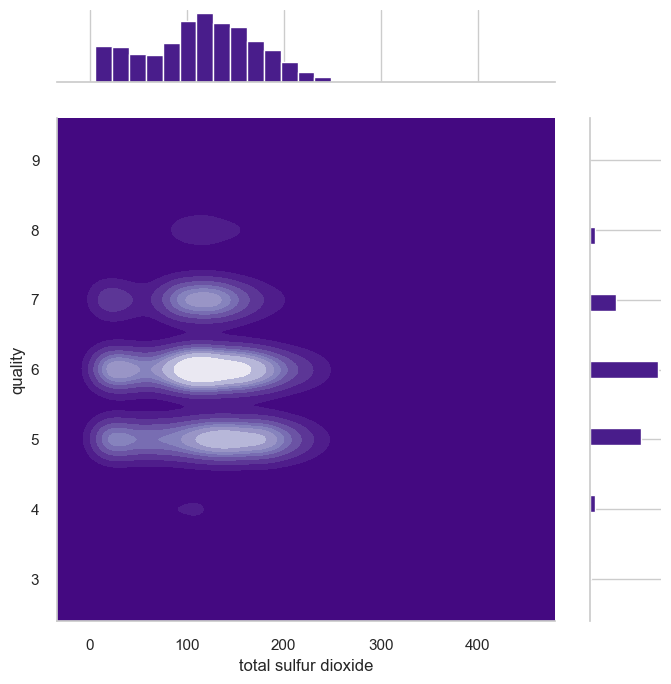

In [118]:
sns.set_theme(style = "whitegrid")
g = sns.JointGrid(data = data, size = 7, x = "total sulfur dioxide", y = "quality", space = 0.5)
g.plot_joint(sns.kdeplot, fill = True, thresh = 0, cmap = "Purples_r")
g.plot_marginals(sns.histplot, color = "#491D8B", alpha = 1, bins = 25);

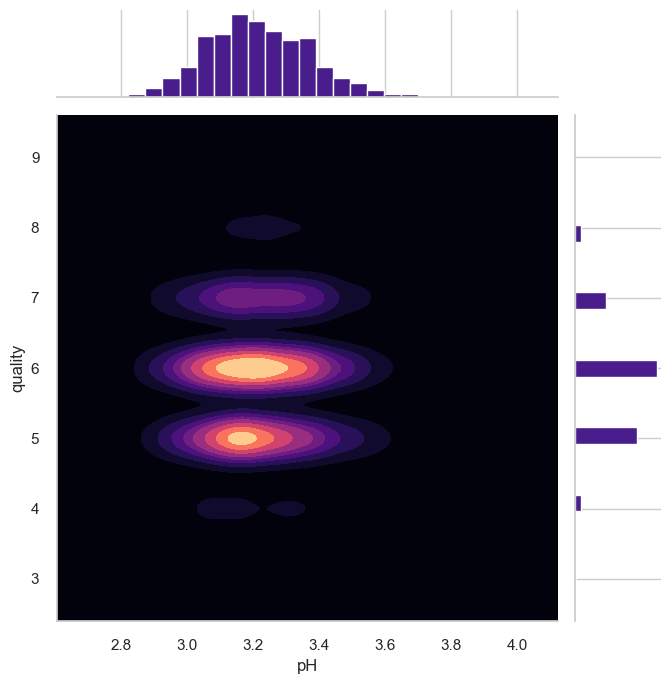

In [119]:
g = sns.JointGrid(data = data, x = "pH", y = "quality", size = 7, space = 0.2)
g.plot_joint(sns.kdeplot, fill = True, thresh = 0, cmap = "magma")
g.plot_marginals(sns.histplot, color = "#491D8B", alpha = 1, bins = 25);

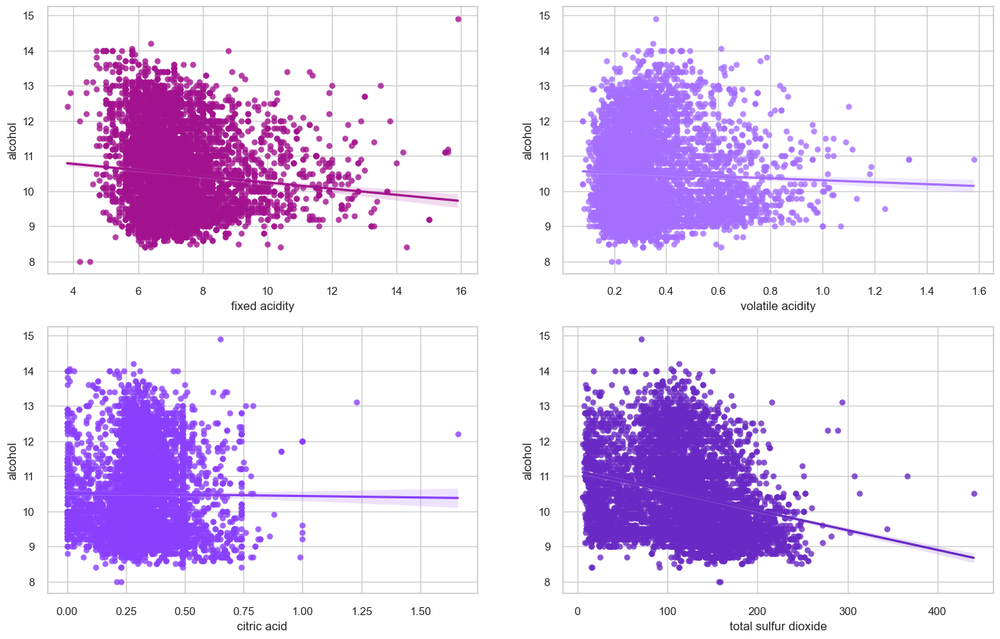

In [120]:
fig, axes = plt.subplots(2, 2, figsize = (15, 10))
axes = axes.flatten()

sns.regplot(ax = axes[0], x = "fixed acidity", y = "alcohol", data = data, color = "#A2128E");
sns.regplot(ax = axes[1], x = "volatile acidity", y = "alcohol", data = data, color = "#A56EFF");
sns.regplot(ax = axes[2], x = "citric acid", y = "alcohol", data = data, color = "#8A3FFC");
sns.regplot(ax = axes[3], x = "total sulfur dioxide", y = "alcohol", data = data, color = "#6929C4");

In [ ]:

fig, ([ax0, ax1], [ax2, ax3]) = plt.subplots(nrows = 2, ncols = 2, figsize = (17, 10))

hb = ax0.hexbin(data["sulphates"], data["quality"], gridsize = 30, cmap = 'Purples_r')
ax0.set_title("Hexagon binning")
cb = fig.colorbar(hb, ax = ax0, label = 'counts')


hb = ax1.hexbin(data["pH"], data["quality"], gridsize = 30, bins = 'log', cmap = 'inferno')
ax1.set_title("With a log color scale")
cb = fig.colorbar(hb, ax = ax1, label = 'log10(N)')


hb = ax2.hexbin(data["density"], data["quality"], gridsize = 20, cmap = 'gist_heat')
ax2.set_title("Hexagon binning")
cb = fig.colorbar(hb, ax = ax2, label = 'counts')

hb = ax3.hexbin(data["free sulfur dioxide"], data["quality"], gridsize = 20, bins = 'log',
                cmap = 'prism')
ax3.set_title("With a log color scale")
cb = fig.colorbar(hb, ax = ax3, label = 'log10(N)')

plt.show()

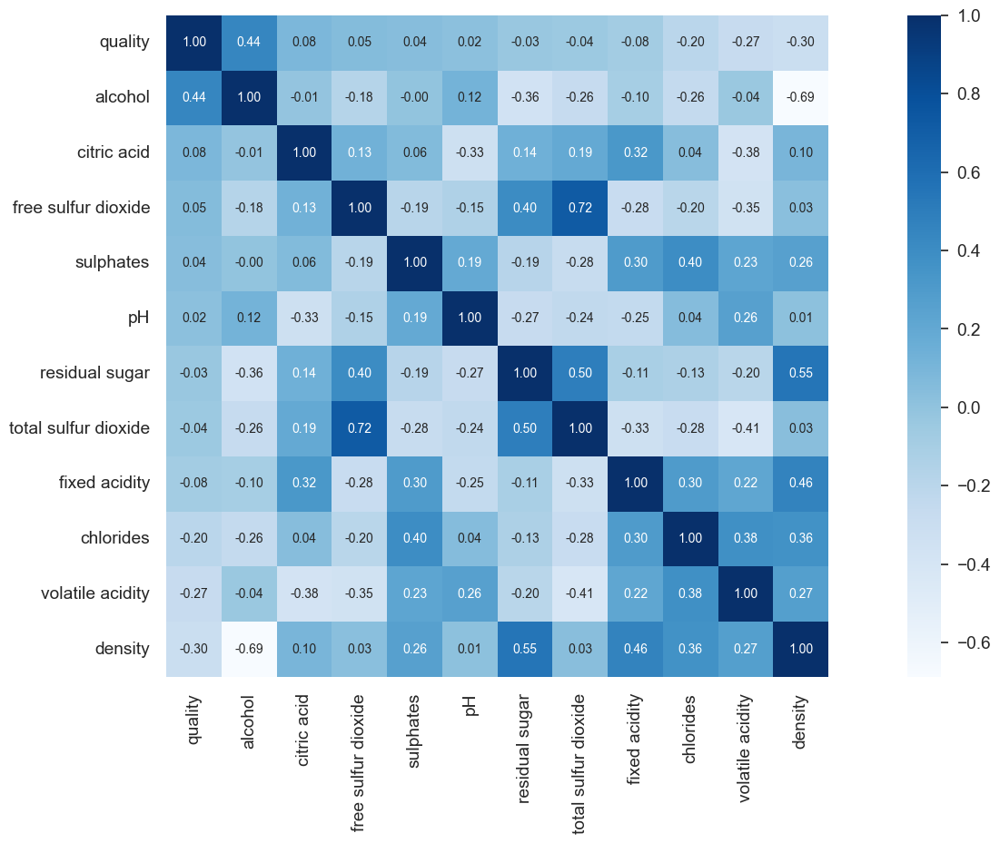

In [129]:
#data = data.dropna(axis=0,how='any')  
##need to drop null first,or it can't show all
corr = data.corr()
plt.figure(figsize=(20, 9))
k = 12 #number of variables for heatmap
cols = corr.nlargest(k, 'quality')['quality'].index
cm = np.corrcoef(data[cols].values.T)
sns.set(font_scale=1.25)
hm = sns.heatmap(cm, cbar=True, annot=True, square=True, fmt='.2f', annot_kws={'size': 10}, yticklabels=cols.values, xticklabels=cols.values,cmap="Blues")
plt.show()

In [19]:
import pandas_profiling
pandas_profiling.ProfileReport(data)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [20]:
import sweetviz as sv

report = sv.analyze(data)
report.show_html()

                                             |                                             | [  0%]   00:00 ->…

Report SWEETVIZ_REPORT.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


In [21]:
from autoviz.AutoViz_Class import AutoViz_Class
AV = AutoViz_Class()
data_AV = AV.AutoViz('winequalityN.csv',chart_format='html')

Imported v0.1.58. After importing, execute '%matplotlib inline' to display charts in Jupyter.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Update: verbose=0 displays charts in your local Jupyter notebook.
        verbose=1 additionally provides EDA data cleaning suggestions. It also displays charts.
        verbose=2 does not display charts but saves them in AutoViz_Plots folder in local machine.
        chart_format='bokeh' displays charts in your local Jupyter notebook.
        chart_format='server' displays charts in your browser: one tab for each chart type
        chart_format='html' silently saves interactive HTML files in your local machine
Shape of your Data Set loaded: (6497, 13)
#######################################################################################
######################## C L A S S 

,Nuniques,dtype,Nulls,Nullpercent,NuniquePercent,Value counts Min,Data cleaning improvement suggestions
density,998,float64,0,0.000000,15.360936,0,
residual sugar,316,float64,2,0.030783,4.863783,0,"fill missing, skewed: cap or drop outliers"
total sulfur dioxide,276,float64,0,0.000000,4.248115,0,
chlorides,214,float64,2,0.030783,3.293828,0,"fill missing, highly skewed: drop outliers or do box-cox transform"
volatile acidity,187,float64,8,0.123134,2.878252,0,"fill missing, skewed: cap or drop outliers"
free sulfur dioxide,135,float64,0,0.000000,2.077882,0,skewed: cap or drop outliers
sulphates,111,float64,4,0.061567,1.708481,0,"fill missing, skewed: cap or drop outliers"
alcohol,111,float64,0,0.000000,1.708481,0,
pH,108,float64,9,0.138525,1.662306,0,fill missing
fixed acidity,106,float64,10,0.153917,1.631522,0,"fill missing, skewed: cap or drop outliers"


    13 Predictors classified...
        No variables removed since no ID or low-information variables found in data set
No scatter plots with depVar when no depVar is given.
Saving pair_scatters in HTML format
Saving distplots_nums in HTML format                                                                                   
Saving violinplots in HTML format                                                                                      
No date vars could be found in data set
Saving heatmaps in HTML format
Saving cat_var_plots in HTML format
Time to run AutoViz (in seconds) = 19                                                                                  


In [22]:
import dtale
import pandas as pd
d = dtale.show(data)
d.open_browser()

# 数据处理

In [99]:
#check null
data.isnull().sum() 

fixed acidity           10
volatile acidity         8
citric acid              3
residual sugar           2
chlorides                2
free sulfur dioxide      0
total sulfur dioxide     0
density                  0
pH                       9
sulphates                4
alcohol                  0
quality                  0
Reviews                  0
dtype: int64

In [192]:
data = data.dropna(axis=0,how='any')

In [101]:
data.isnull().sum() 

fixed acidity           0
volatile acidity        0
citric acid             0
residual sugar          0
chlorides               0
free sulfur dioxide     0
total sulfur dioxide    0
density                 0
pH                      0
sulphates               0
alcohol                 0
quality                 0
Reviews                 0
dtype: int64

In [196]:
#check outliers
def detect_outliers(df,features):
    outlier_indices = []
    
    for c in features:
        # 1st quartile
        Q1 = np.percentile(df[c],25)
        # 3rd quartile
        Q3 = np.percentile(df[c],75)
        # IQR
        IQR = Q3 - Q1
        # Outlier step
        outlier_step = IQR * 1.5
        # detect outlier and their indeces
        outlier_list_col = df[(df[c] < Q1 - outlier_step) | (df[c] > Q3 + outlier_step)].index
        # store indeces
        outlier_indices.extend(outlier_list_col)
    
    outlier_indices = Counter(outlier_indices)
    multiple_outliers = list(i for i, v in outlier_indices.items() if v > 2)
    
    return multiple_outliers

In [103]:
data.iloc[detect_outliers(data,data.columns[:-1])]

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,Reviews
2897,6.7,0.42,0.46,9.70,0.054,67.0,234.0,0.99848,3.23,0.50,9.0,5,1
4285,6.0,0.20,0.26,6.80,0.049,22.0,93.0,0.99280,3.15,0.42,11.0,6,2
5252,6.1,0.21,0.40,1.40,0.066,40.5,165.0,0.99120,3.25,0.59,11.9,6,2
5256,11.9,0.43,0.66,3.10,0.109,10.0,23.0,1.00000,3.15,0.85,10.4,7,2
5257,12.6,0.38,0.66,2.60,0.088,10.0,41.0,1.00100,3.17,0.68,9.8,6,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1955,6.4,0.29,0.28,11.10,0.063,66.0,169.0,0.99730,2.89,0.57,9.0,5,1
2772,6.2,0.29,0.32,3.60,0.026,39.0,138.0,0.98920,3.31,0.37,13.1,7,2
2774,7.0,0.36,0.32,10.05,0.045,37.0,131.0,0.99352,3.09,0.33,11.7,8,3
2956,8.1,0.12,0.38,0.90,0.034,36.0,86.0,0.99026,2.80,0.55,12.0,6,2


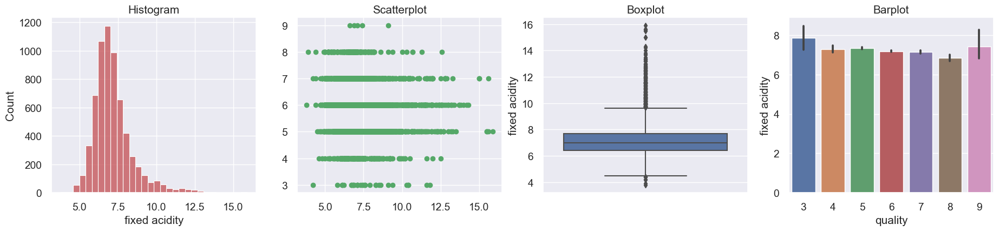

In [138]:
diagnostic_plots(data,'fixed acidity','quality')

In [104]:
from feature_engine.outliers import Winsorizer
windsoriser = Winsorizer(capping_method='iqr', 
                          tail='both', # cap left, right or both tails 
                          fold=1.5,
                          variables=['fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar',
                                     'chlorides', 'free sulfur dioxide', 'total sulfur dioxide', 'density',
                                     'pH', 'sulphates'])

In [197]:
windsoriser.fit(data)

Winsorizer(capping_method='iqr', fold=1.5, tail='both',
           variables=['fixed acidity', 'volatile acidity', 'citric acid',
                      'residual sugar', 'chlorides', 'free sulfur dioxide',
                      'total sulfur dioxide', 'density', 'pH', 'sulphates'])

In [198]:
data = windsoriser.transform(data)

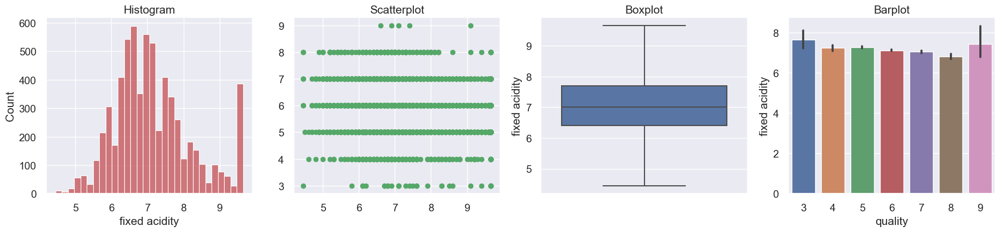

In [142]:
diagnostic_plots(data,'fixed acidity','quality')

In [143]:
cols = ['fixed acidity', 'volatile acidity', 'residual sugar',
       'chlorides', 'free sulfur dioxide', 'total sulfur dioxide',
       'sulphates', 'alcohol']

In [107]:
#deal pianyi
import feature_engine.transformation as vt
lt = vt.LogTransformer(variables = cols)

lt.fit(data)


LogTransformer(variables=['fixed acidity', 'volatile acidity', 'residual sugar',
                          'chlorides', 'free sulfur dioxide',
                          'total sulfur dioxide', 'sulphates', 'alcohol'])

In [108]:
data = lt.transform(data)

In [199]:
#aniother method deal pianyi
import feature_engine.transformation as vt
bt = vt.BoxCoxTransformer(variables = cols)

bt.fit(data)

BoxCoxTransformer(variables=['fixed acidity', 'volatile acidity',
                             'residual sugar', 'chlorides',
                             'free sulfur dioxide', 'total sulfur dioxide',
                             'sulphates', 'alcohol'])

In [200]:
data = bt.transform(data)

In [201]:
x = data.iloc[:,:11]
y = data['Reviews']

In [110]:
x.head(10)

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol
0,1.945910,-1.309333,0.36,2.865054,-3.101093,3.806662,5.135798,1.0010,3.00,-0.798508,2.174752
1,1.840550,-1.203973,0.34,0.470004,-3.015935,2.639057,4.882802,0.9940,3.30,-0.713350,2.251292
2,2.091864,-1.272966,0.40,1.931521,-2.995732,3.401197,4.574711,0.9951,3.26,-0.820981,2.312535
3,1.974081,-1.469676,0.32,2.140066,-2.847312,3.850148,5.225747,0.9956,3.19,-0.916291,2.292535
4,1.974081,-1.469676,0.32,2.140066,-2.847312,3.850148,5.225747,0.9956,3.19,-0.916291,2.292535
5,2.091864,-1.272966,0.40,1.931521,-2.995732,3.401197,4.574711,0.9951,3.26,-0.820981,2.312535
6,1.824549,-1.139434,0.16,1.945910,-3.101093,3.401197,4.912655,0.9949,3.18,-0.755023,2.261763
7,1.945910,-1.309333,0.36,2.865054,-3.101093,3.806662,5.135798,1.0010,3.00,-0.798508,2.174752
8,1.840550,-1.203973,0.34,0.470004,-3.015935,2.639057,4.882802,0.9940,3.30,-0.713350,2.251292
9,2.091864,-1.514128,0.43,0.405465,-3.123566,3.332205,4.859812,0.9938,3.22,-0.798508,2.397895


In [152]:
y.head(10)

0    2
1    2
2    2
3    2
4    2
5    2
6    2
7    2
8    2
9    2
Name: Reviews, dtype: object

In [202]:
#standarlization
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
x = sc.fit_transform(x)

In [112]:
#view the scaled features
print(x)

[[-0.06599064 -0.28535074  0.33182821 ... -1.37869621 -0.5181958
  -1.52389701]
 [-0.78823881 -0.03398901  0.17999772 ...  0.52326155 -0.17050779
  -0.83640894]
 [ 0.93452598 -0.19858736  0.6354892  ...  0.26966718 -0.60994948
  -0.28631463]
 ...
 [-0.78823881  1.23194664 -1.41422246 ...  1.28404465  1.56743728
   0.48039321]
 [-1.23790933  1.79221045 -1.49013771 ...  2.23502353  1.34366254
  -0.19782065]
 [-1.12269624  0.04423865  1.16689592 ...  1.09384887  1.04551062
   0.48039321]]


In [203]:
#PCA
from sklearn.decomposition import PCA
pca = PCA()
x_pca = pca.fit_transform(x)

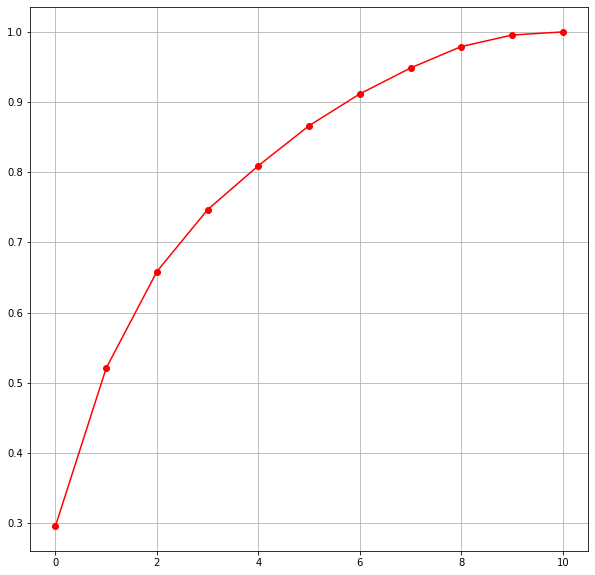

In [114]:
#plot the graph to find the principal components
plt.figure(figsize=(10,10))
plt.plot(np.cumsum(pca.explained_variance_ratio_), 'ro-')
plt.grid()

In [204]:
pca_new = PCA(n_components=8)
x_new = pca_new.fit_transform(x)

In [116]:
print(x_new)

[[-0.96268373 -3.3521664  -0.32915734 ...  0.38946207  0.47076008
   0.18375949]
 [ 0.06348184  0.50451132 -0.40288924 ...  0.22026121 -0.13662529
   0.73960185]
 [-0.16483451 -0.86823357  0.45299395 ...  0.46964363 -0.71195598
  -0.61726858]
 ...
 [ 2.15355442  1.09527169 -1.87108615 ... -0.60856413  0.25306585
   0.15399245]
 [ 2.25550341  1.19995466 -2.86809718 ... -0.54284261 -0.34198154
   0.34183355]
 [ 1.14435286  0.55577153 -0.12397953 ...  1.06074464 -0.44355499
   1.22132151]]


In [205]:
#divide train_test
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x_new, y, test_size = 0.1)

In [118]:
print(x_train.shape)
print(y_train.shape)
print(x_test.shape)
print(y_test.shape)

(5816, 8)
(5816,)
(647, 8)
(647,)


In [206]:
#model
from sklearn.tree import DecisionTreeClassifier
dt = DecisionTreeClassifier()
dt.fit(x_train,y_train)
dt_predict = dt.predict(x_test)

In [207]:
from sklearn.metrics import confusion_matrix, accuracy_score
#print confusion matrix and accuracy score
dt_conf_matrix = confusion_matrix(y_test, dt_predict)
dt_acc_score = accuracy_score(y_test, dt_predict)
print(dt_conf_matrix)
print(dt_acc_score*100)

[[159  80   2]
 [ 70 303  10]
 [  1  18   4]]
72.02472952086553


In [210]:
from sklearn.tree import DecisionTreeClassifier
dt = DecisionTreeClassifier(criterion = 'gini', max_features=7, max_leaf_nodes=750, random_state = 1)
dt.fit(x_train,y_train)
dt_predict = dt.predict(x_test)

In [211]:
from sklearn.metrics import confusion_matrix, accuracy_score
#print confusion matrix and accuracy score
dt_conf_matrix = confusion_matrix(y_test, dt_predict)
dt_acc_score = accuracy_score(y_test, dt_predict)
print(dt_conf_matrix)
print(dt_acc_score*100)

[[162  78   1]
 [ 77 297   9]
 [  1  16   6]]
71.87017001545595


In [208]:
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier(n_estimators=200)
rfc.fit(x_train, y_train)
rfc_predict = rfc.predict(x_test)

In [209]:
rfc_conf_matrix = confusion_matrix(y_test, rfc_predict)
rfc_acc_score = accuracy_score(y_test, rfc_predict)
print(rfc_conf_matrix)
print(rfc_acc_score)

[[154  87   0]
 [ 32 350   1]
 [  0  19   4]]
0.7851622874806801


In [58]:
#tyy atempt2.1 not StandardScaler
from sklearn.preprocessing import MinMaxScaler
norm = MinMaxScaler(feature_range = (0, 1))
norm.fit(x_train)
x_train = norm.transform(x_train)
x_test = norm.transform(x_test)

In [59]:
from sklearn.tree import DecisionTreeClassifier
dt = DecisionTreeClassifier()
dt.fit(x_train,y_train)
dt_predict = dt.predict(x_test)

In [60]:
dt_conf_matrix = confusion_matrix(y_test, dt_predict)
dt_acc_score = accuracy_score(y_test, dt_predict)
print(dt_conf_matrix)
print(dt_acc_score*100)

[[151  74   1]
 [ 68 328  10]
 [  0  11   4]]
74.65224111282845


In [61]:
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier(n_estimators=200)
rfc.fit(x_train, y_train)
rfc_predict = rfc.predict(x_test)

In [62]:
rfc_conf_matrix = confusion_matrix(y_test, rfc_predict)
rfc_acc_score = accuracy_score(y_test, rfc_predict)
print(rfc_conf_matrix)
print(rfc_acc_score)

[[160  66   0]
 [ 42 364   0]
 [  0  12   3]]
0.8145285935085008


In [214]:
#tyy atempt2
# Fitting classifier to the Training set
from sklearn.tree import DecisionTreeClassifier
classifier_dt = DecisionTreeClassifier(criterion = 'gini', max_features=7, max_leaf_nodes=400, random_state = 1)
classifier_dt.fit(x_train, y_train.ravel())

DecisionTreeClassifier(max_features=7, max_leaf_nodes=400, random_state=1)

In [217]:
#tyy atempt2
# Predicting Cross Validation Score
from sklearn.model_selection import cross_val_score
cv_dt = cross_val_score(estimator = classifier_dt, X = x_train, y = y_train.ravel(), cv = 10)
print("CV: ", cv_dt.mean())

y_pred_dt_train = classifier_dt.predict(x_train)
accuracy_dt_train = accuracy_score(y_train, y_pred_dt_train)
print("Training set: ", accuracy_dt_train)

y_pred_dt_test = classifier_dt.predict(x_test)
accuracy_dt_test = accuracy_score(y_test, y_pred_dt_test)
print("Test set: ", accuracy_dt_test)

CV:  0.7371116276593856
Training set:  0.9085281980742779
Test set:  0.7125193199381762


In [218]:
#tyy atempt2
# Fitting Random Forest Classification to the Training set
from sklearn.ensemble import RandomForestClassifier
classifier_rf = RandomForestClassifier(criterion = 'entropy', max_features = 6, n_estimators = 400, random_state=1)
classifier_rf.fit(x_train, y_train.ravel())

RandomForestClassifier(criterion='entropy', max_features=6, n_estimators=400,
                       random_state=1)

In [127]:
#tyy atempt2
# Predicting Cross Validation Score
cv_rf = cross_val_score(estimator = classifier_rf, X = x_train, y = y_train.ravel(), cv = 5)
print("CV: ", cv_rf.mean())

y_pred_rf_train = classifier_rf.predict(x_train)
accuracy_rf_train = accuracy_score(y_train, y_pred_rf_train)
print("Training set: ", accuracy_rf_train)

y_pred_rf_test = classifier_rf.predict(x_test)
accuracy_rf_test = accuracy_score(y_test, y_pred_rf_test)
print("Test set: ", accuracy_rf_test)

CV:  0.7974532625364548
Training set:  1.0
Test set:  0.8207109737248841
